In [1]:
import numpy as np
import open3d as o3d
import cv2
import matplotlib.pyplot as plt
import math
import mrob
import pandas as pd
from os import listdir
from easydict import EasyDict as edict

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [2]:
filtered_poses = pd.read_csv('../mocap_imu_offset_obtaining_/mocap_poses_with_aligned_timestamps_filtered.csv')
filtered_poses

,Unnamed: 0,X,Y,Z,W,X.1,Y.1,Z.1,IMU_Timestamp
0,0,0.584725,0.653716,0.399051,-0.267413,-1.026712,0.413419,1.089505,600
1,1,0.584788,0.654034,0.398662,-0.267076,-1.026708,0.413428,1.089501,633
2,2,0.584776,0.654288,0.398387,-0.266886,-1.026702,0.413439,1.089507,667
3,3,0.584785,0.654104,0.398591,-0.267018,-1.026703,0.413428,1.089501,700
4,4,0.584851,0.654483,0.398098,-0.266683,-1.026698,0.413449,1.089512,733
...,...,...,...,...,...,...,...,...,...
1116,1116,-0.466771,-0.547856,-0.152746,-0.677235,0.445169,1.300189,-0.831378,37794
1117,1117,-0.466534,-0.548770,-0.152685,-0.676672,0.445438,1.300239,-0.831112,37827
1118,1118,-0.466709,-0.549315,-0.152152,-0.676228,0.445753,1.300453,-0.830898,37861
1119,1119,-0.467436,-0.549941,-0.153250,-0.674968,0.446105,1.300841,-0.830722,37894


In [3]:
def load_video(args):
    cap = cv2.VideoCapture(args.run_sequence)
    if cap.isOpened() == False:
        print("Error opening video stream or file")
    frames = []
    ind = 0
    while True:

        ret, frame = cap.read()
        if not ret:
            break

        if ind % args.skip != 0:
            ind = ind + 1
            continue
        ind = ind + 1
        frame = cv2.rotate(frame, cv2.ROTATE_180)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)
    return frames



In [4]:
def triangle_pose(args_):
    """
    :param mrob_se3: mrob.geometry.SE3(4x4)
    :return: triangle head, triangle tail
    """
    T_rect = np.load(args_.T_rect)
    FT_C_s20 = np.load(args_.FT_C_s20)
    mrob_se3 = mrob.geometry.SE3(T_rect) * mrob.geometry.SE3(args_.mobile2rect) * mrob.geometry.SE3(FT_C_s20)

    azure2rect_origin = mrob_se3.T() @ np.array([0, 0, 0, 1])
    azure2rect_z_axis = mrob_se3.T() @ np.array([0, 0, 1, 1])

    poses_x_coords = azure2rect_origin[0]
    poses_y_coords = azure2rect_origin[1]

    poses_dx = azure2rect_z_axis[0] - azure2rect_origin[0]
    poses_dy = azure2rect_z_axis[1] - azure2rect_origin[1]

    return (poses_x_coords, poses_y_coords), (poses_dx, poses_dy)

In [5]:
def quat_to_SE3(quat_pose):
    
    rot_4x1 = quat_pose[1:5]
    tra_3x1 = quat_pose[5:-1]

    rot = mrob.geometry.quat_to_so3(rot_4x1)
    pose = mrob.geometry.SE3(mrob.geometry.SO3(rot),tra_3x1)

    return pose

In [6]:
def main(args_, plot_3d=False):
    
    # query pose 
    (mobile_x_coords, mobile_y_coords), (mobile_dx, mobile_dy) = triangle_pose(args_)
    print(mobile_x_coords, mobile_y_coords, mobile_dx, mobile_dy)

    # query image
    img_query = cv2.imread(args_.query_name)
    img_query = cv2.cvtColor(img_query, cv2.COLOR_BGR2RGB)

    if plot_3d:

        # match_axis = o3d.geometry.TriangleMesh.create_coordinate_frame(size=0.2).transform(args_.mobile2rect.T())
        query_axis = o3d.geometry.TriangleMesh.create_coordinate_frame(size=0.3).transform(args_.mobile2rect.T())
        map_3d = o3d.io.read_point_cloud(args_.map_points_pcd)
            
        o3d.visualization.draw_geometries([map_3d, query_axis])

    pcd = o3d.io.read_point_cloud(args_.map_points_pcd)
    map_points = np.asarray(pcd.points)
    map_colors = np.asarray(pcd.colors)


    fig, axd = plt.subplot_mosaic(
        [["query", "map"]],
        figsize=(10, 10),
        constrained_layout=True,
    )
    
    axd['query'].imshow(img_query)

    axd['map'].scatter(
        map_points[:, 0],
        map_points[:, 1],
        color=map_colors,
        s=5,
        marker=".",
        alpha=0.7,
        label="map",
    )


    axd['map'].arrow(
            mobile_x_coords,
            mobile_y_coords,
            mobile_dx * 0.2,
            mobile_dy * 0.2,
            width=0.1,
            alpha=0.7,
            color="red",
            head_width=0.1,
            head_length=math.sqrt(
                (mobile_dx * 0.2) ** 2 + (mobile_dy * 0.2) ** 2
            ),
            length_includes_head=True,
            head_starts_at_zero=False,
        )

    # axd["map"].axis("off")
    axd["query"].axis("off")
    axd['map'].set_aspect('equal')

    plt.show()

0.9941722390335866 0.18082702129755457 0.2893884536791077 -0.8443830940060166


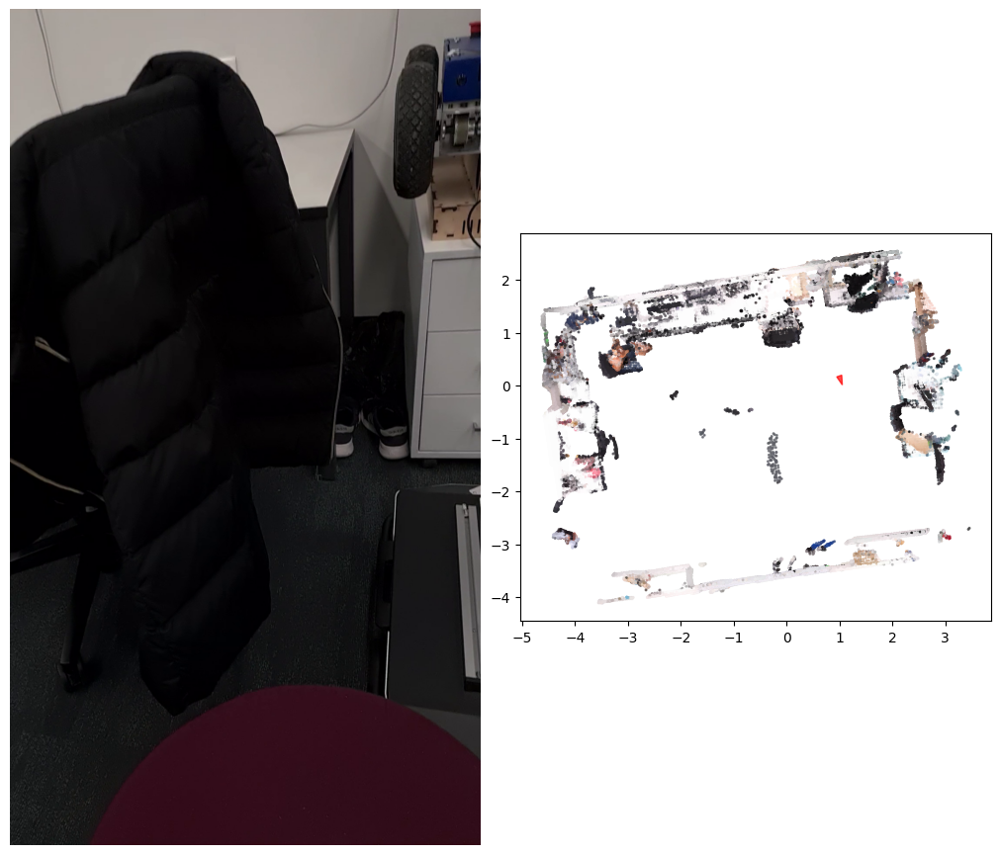

In [7]:
args_= edict()
args_.query_index = 0
args_.map_points_pcd = '../mnt/patata/datasets/navigine/mocab/apriltag/Azure/mocap/map_rect_walls.pcd'
args_.T_rect =  '../mnt/patata/datasets/navigine/mocab/dataset/lab_hekmat_mocap_1/T_rect.npy'
args_.FT_C_s20 = '../mnt/patata/datasets/navigine/mocab/apriltag/Azure/mocap/pcds/FT_C_s20.npy'

index = 650
frame_index = int(filtered_poses.iloc[index]['IMU_Timestamp'])
args_.mobile2rect = quat_to_SE3(filtered_poses.iloc[index])
args_.query_name = f'../mocap_imu_offset_obtaining_/frames_from_2802_video/{frame_index}.png'

main(args_, plot_3d=False)

In [8]:
filtered_poses[650:]

,Unnamed: 0,X,Y,Z,W,X.1,Y.1,Z.1,IMU_Timestamp
650,650,0.510287,0.852847,0.109976,-0.003249,-1.047234,0.793638,0.970136,22263
651,651,0.509107,0.853243,0.112022,-0.008438,-1.048416,0.821326,0.961384,22296
652,652,0.510017,0.852282,0.114166,-0.006193,-1.049670,0.846561,0.952457,22330
653,653,0.501241,0.861026,0.083231,0.008765,-1.049892,0.871085,0.944612,22363
654,654,0.491619,0.867977,0.051238,0.028707,-1.050756,0.897254,0.934933,22396
...,...,...,...,...,...,...,...,...,...
1116,1116,-0.466771,-0.547856,-0.152746,-0.677235,0.445169,1.300189,-0.831378,37794
1117,1117,-0.466534,-0.548770,-0.152685,-0.676672,0.445438,1.300239,-0.831112,37827
1118,1118,-0.466709,-0.549315,-0.152152,-0.676228,0.445753,1.300453,-0.830898,37861
1119,1119,-0.467436,-0.549941,-0.153250,-0.674968,0.446105,1.300841,-0.830722,37894


In [11]:
np.array(filtered_poses.iloc[650][1:5])

array([ 0.510287  ,  0.85284657,  0.10997614, -0.00324886])

In [10]:
map_3d = o3d.io.read_point_cloud(args_.map_points_pcd)
            
o3d.visualization.draw_plotly([map_3d])